In [23]:
from ydata_profiling import ProfileReport
import pandas as pd
import numpy as np
from ucimlrepo import fetch_ucirepo 
import matplotlib.pyplot as plt
import seaborn as sns
from IPython.display import HTML
from matplotlib.animation import FuncAnimation




RANDOM_STATE = 42

In [24]:
abalone = fetch_ucirepo(id=1) 

X = abalone.data.features 
y = abalone.data.targets

print(abalone.metadata) 
print(abalone.variables) 

{'uci_id': 1, 'name': 'Abalone', 'repository_url': 'https://archive.ics.uci.edu/dataset/1/abalone', 'data_url': 'https://archive.ics.uci.edu/static/public/1/data.csv', 'abstract': 'Predict the age of abalone from physical measurements', 'area': 'Biology', 'tasks': ['Classification', 'Regression'], 'characteristics': ['Tabular'], 'num_instances': 4177, 'num_features': 8, 'feature_types': ['Categorical', 'Integer', 'Real'], 'demographics': [], 'target_col': ['Rings'], 'index_col': None, 'has_missing_values': 'no', 'missing_values_symbol': None, 'year_of_dataset_creation': 1994, 'last_updated': 'Mon Aug 28 2023', 'dataset_doi': '10.24432/C55C7W', 'creators': ['Warwick Nash', 'Tracy Sellers', 'Simon Talbot', 'Andrew Cawthorn', 'Wes Ford'], 'intro_paper': None, 'additional_info': {'summary': 'Predicting the age of abalone from physical measurements.  The age of abalone is determined by cutting the shell through the cone, staining it, and counting the number of rings through a microscope -- 

In [25]:
data = pd.DataFrame(X)
# data['target'] = y

In [26]:
profile = ProfileReport(data, title='Pandas Profiling Report', explorative=True)
profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

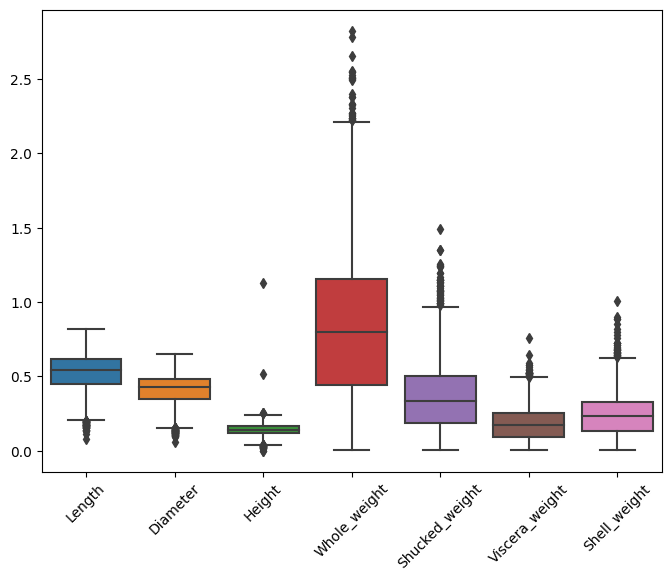

In [27]:
%matplotlib inline
import matplotlib.pyplot as plt

plt.figure(figsize=(8, 6))
sns.boxplot(data=data)
plt.xticks(rotation=45)
None 

# EDA for Abalone Clastetring

The dataset is about the physical measurements of abalone. The main goal is to predict the age of abalone from physical measurements determined by cutting the shell through the cone, staining it, and counting the number of rings through a microscope. But here we are going to perform clustering on the dataset to see if we can find any patterns in the data.

- 4177 observations
- 8 features
    - 7 continuous features
    - 1 categorical feature SEX M- Man, F- Female, I- Infant
- There are no missing values in the dataset
- The all numerical features are very correlated with each other
- Data will need scaling before applying clustering algorithms
- Data have some outliers but set is small so we can't remove them


In [28]:
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import OneHotEncoder, StandardScaler, MinMaxScaler
from sklearn.cluster import KMeans, DBSCAN
from sklearn.metrics import silhouette_score, calinski_harabasz_score, davies_bouldin_score

In [29]:
categorical_features = ['Sex']
numeric_features = ["Length", "Diameter", "Height", "Whole_weight", "Shucked_weight", "Viscera_weight", "Shell_weight"]

preprocessor = ColumnTransformer(
    transformers=[
        ('num', MinMaxScaler(), numeric_features),
        ('cat', OneHotEncoder(), categorical_features)
    ])

In [30]:
X_preprocessed = preprocessor.fit_transform(data)

c:\Users\Konrad\AppData\Local\Programs\Python\Python311\Lib\site-packages\umap\umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


Text(0.5, 1.0, 'UMAP')

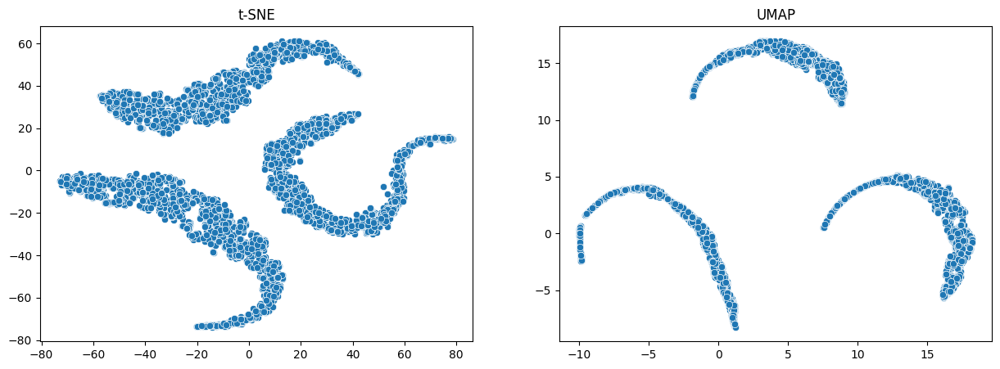

In [31]:
from sklearn.manifold import TSNE
from umap import UMAP

tsne = TSNE(n_components=2, random_state=RANDOM_STATE)
X_tsne = tsne.fit_transform(X_preprocessed)

umap = UMAP(n_components=2, random_state=RANDOM_STATE)
X_umap = umap.fit_transform(X_preprocessed)

fig, ax = plt.subplots(1, 2, figsize=(15, 5))

sns.scatterplot(x=X_tsne[:, 0], y=X_tsne[:, 1], ax=ax[0])
ax[0].set_title("t-SNE")

sns.scatterplot(x=X_umap[:, 0], y=X_umap[:, 1], ax=ax[1])
ax[1].set_title("UMAP")


In [32]:
def evaluate_clustering(X_preprocessed, labels, name, print_metrics=False):
    silhouette_score_value = silhouette_score(X_preprocessed, labels)
    calinski_harabasz_score_value = calinski_harabasz_score(X_preprocessed, labels)
    davies_bouldin_score_value = davies_bouldin_score(X_preprocessed, labels)

    if print_metrics:
        print(f"Metrics for {name}:")
        print(f"Silhouette Score: {silhouette_score_value}")
        print(f"Calinski Harabasz Score: {calinski_harabasz_score_value}")
        print(f"Davies Bouldin Score: {davies_bouldin_score_value}")
        print()

    return {
            "Silhouette Score": silhouette_score_value,
            "Calinski Harabasz Score": calinski_harabasz_score_value,
            "Davies Bouldin Score": davies_bouldin_score_value,
            "Name": name
        }

In [33]:
%matplotlib notebook

# KMeans

In [34]:
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.cluster import KMeans
import pandas as pd

scores = pd.DataFrame()

cluster_range = range(2, 10)  


fig, axs = plt.subplots(1, 3, figsize=(25, 7))


def update(frame):
    for ax in axs.flat:
        ax.clear()

    n_clusters = cluster_range[frame]
    
    kmeans = KMeans(n_clusters=n_clusters, random_state=RANDOM_STATE)
    labels_kmeans = kmeans.fit_predict(X_preprocessed)
    
    sns.scatterplot(x=X_tsne[:, 0], y=X_tsne[:, 1], hue=labels_kmeans, ax=axs[0], palette='viridis')
    axs[0].set_title(f"t-SNE - KMeans {n_clusters} clusters")
    
    sns.scatterplot(x=X_umap[:, 0], y=X_umap[:, 1], hue=labels_kmeans, ax=axs[1], palette='viridis')
    axs[1].set_title(f"UMAP - KMeans {n_clusters} clusters")

    metrics = evaluate_clustering(X_preprocessed, labels_kmeans, f"KMeans {n_clusters} clusters")

    global scores
    scores = pd.concat([scores, pd.DataFrame([metrics])])

    sns.lineplot(data=scores, x='Name', y='Silhouette Score', marker='o', ax=axs[2], color='green', label='Silhouette Score', legend=False)
    sns.lineplot(data=scores, x='Name', y='Davies Bouldin Score', marker='o', ax=axs[2], color='blue', label='Davies Bouldin Score', legend=False)
    
    axs2 = axs[2].twinx()

    sns.lineplot(data=scores, x='Name', y='Calinski Harabasz Score', marker='o', ax=axs2, color='red', label='Calinski Harabasz Score', legend=False)

    axs[2].set_title("Clustering Metrics")
    axs[2].set_xticks(scores['Name'])
    axs[2].set_xticklabels(scores['Name'], rotation=45)
    axs[2].set_ylabel("Silhouette / Davies Bouldin")
    axs2.set_ylabel("Calinski Harabasz")


    # Get legend handles and labels
    lines, labels = axs[2].get_legend_handles_labels()
    lines2, labels2 = axs2.get_legend_handles_labels()
    axs2.set_ylim(3000, 18000)

    # Combine legends
    axs[2].legend(lines + lines2, labels + labels2, loc='best')


anim = FuncAnimation(fig, update, frames=len(cluster_range), interval=1000)


HTML(anim.to_jshtml())


<IPython.core.display.Javascript object>

In [35]:
scores = scores[1:]
scores

,Silhouette Score,Calinski Harabasz Score,Davies Bouldin Score,Name
0,0.518045,3532.188791,0.769758,KMeans 2 clusters
0,0.750190,14433.591734,0.380797,KMeans 3 clusters
0,0.654193,13369.137586,0.532247,KMeans 4 clusters
0,0.572186,13598.032127,0.642713,KMeans 5 clusters
0,0.557935,12061.226136,0.670216,KMeans 6 clusters
0,0.547227,12095.283580,0.679019,KMeans 7 clusters
0,0.467297,16200.822514,0.721324,KMeans 8 clusters
0,0.450449,15321.538718,0.756399,KMeans 9 clusters


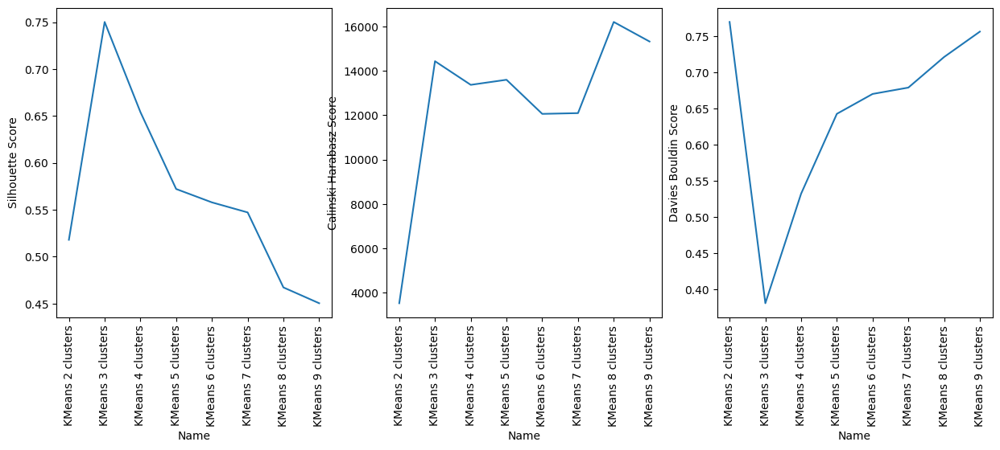

In [36]:
%matplotlib inline

fig, ax = plt.subplots(1, 3, figsize=(15, 5))
sns.lineplot(data=scores, x='Name', y='Silhouette Score', ax=ax[0])
ax[0].xaxis.set_tick_params(rotation=90)

sns.lineplot(data=scores, x='Name', y='Calinski Harabasz Score', ax=ax[1])
ax[1].xaxis.set_tick_params(rotation=90)

sns.lineplot(data=scores, x='Name', y='Davies Bouldin Score', ax=ax[2])
ax[2].xaxis.set_tick_params(rotation=90)


Silhouette coefficient is a numerical representation ranging from -1 to 1. Value 1 means each cluster completely differed from the others, and value  -1 means all the data was assigned to the wrong cluster. 0 means there are no meaningful clusters from the data. **Higher the value better the cluster.**

Calinski-Harabasz Index or Variance Ratio Criterion is an index that is used to evaluate cluster quality by measuring the ratio of between-cluster dispersion to within-cluster dispersion. Basically, we measured the differences between the sum squared distance of the data between the cluster and data within the internal cluster. **Higher the value better the cluster.**

Davies-Bouldin Index is a clustering evaluation metric measured by calculating the average similarity between each cluster and its most similar one. The ratio of within-cluster distances to between-cluster distances calculates the similarity. This means the further apart the clusters and the less dispersed would lead to better scores. **Lower the value better the cluster.**


In [37]:
%matplotlib notebook

# DBSCAN Clustering

In [38]:
eps = np.arange(0.1, 1.2, 0.2)
min_samples = range(2, 12, 2)
scores = pd.DataFrame()

fig, axs = plt.subplots(1, 3, figsize=(25, 7))

def update(frame):
    for ax in axs.flat:
        ax.clear()

    idx = frame // len(min_samples)
    jdx = frame % len(min_samples)

    e = round(eps[idx], 1)
    ms = min_samples[jdx]
        
    dbscan = DBSCAN(eps=e, min_samples=ms)
    labels_dbscan = dbscan.fit_predict(X_preprocessed)

    sns.scatterplot(x=X_tsne[:, 0], y=X_tsne[:, 1], hue=labels_dbscan, ax=axs[0], palette='viridis')
    axs[0].set_title(f"t-SNE - DBSCAN eps={e}, min_samples={ms}")

    sns.scatterplot(x=X_umap[:, 0], y=X_umap[:, 1], hue=labels_dbscan, ax=axs[1], palette='viridis')
    axs[1].set_title(f"UMAP - DBSCAN eps={e}, min_samples={ms}")

    metrics = evaluate_clustering(X_preprocessed, labels_dbscan, f"DBSCAN eps={e}, min_samples={ms}")

    global scores
    scores = pd.concat([scores, pd.DataFrame([metrics])])

    sns.lineplot(data=scores, x='Name', y='Silhouette Score', marker='o', ax=axs[2], color='green', label='Silhouette Score', legend=False)
    sns.lineplot(data=scores, x='Name', y='Davies Bouldin Score', marker='o', ax=axs[2], color='blue', label='Davies Bouldin Score', legend=False)
    
    axs2 = axs[2].twinx()

    sns.lineplot(data=scores, x='Name', y='Calinski Harabasz Score', marker='o', ax=axs2, color='red', label='Calinski Harabasz Score', legend=False)

    axs[2].set_title("Clustering Metrics")
    axs[2].set_xticks(scores['Name'])
    axs[2].set_xticklabels(scores['Name'], rotation=90)
    axs[2].set_ylabel("Silhouette / Davies Bouldin")
    axs2.set_ylabel("Calinski Harabasz")

    # Get legend handles and labels
    lines, labels = axs[2].get_legend_handles_labels()
    lines2, labels2 = axs2.get_legend_handles_labels()
    axs2.set_ylim(1000, 18000)

    # Combine legends
    axs[2].legend(lines + lines2, labels + labels2, loc='best')

anim = FuncAnimation(fig, update, frames=len(eps) * len(min_samples), interval=1000)

plt.tight_layout()

HTML(anim.to_jshtml())

<IPython.core.display.Javascript object>

In [39]:
scores = scores[1:]
scores

,Silhouette Score,Calinski Harabasz Score,Davies Bouldin Score,Name
0,-0.060871,1949.438739,1.140548,"DBSCAN eps=0.1, min_samples=2"
0,0.683554,8620.799029,1.243016,"DBSCAN eps=0.1, min_samples=4"
0,0.599867,6491.689253,1.179002,"DBSCAN eps=0.1, min_samples=6"
0,0.603202,6390.711786,1.150839,"DBSCAN eps=0.1, min_samples=8"
0,0.673445,8327.214888,1.140616,"DBSCAN eps=0.1, min_samples=10"
0,0.710470,9642.704678,0.356739,"DBSCAN eps=0.3, min_samples=2"
0,0.710470,9642.704678,0.356739,"DBSCAN eps=0.3, min_samples=4"
0,0.710470,9642.704678,0.356739,"DBSCAN eps=0.3, min_samples=6"
0,0.710470,9642.704678,0.356739,"DBSCAN eps=0.3, min_samples=8"
0,0.710470,9642.704678,0.356739,"DBSCAN eps=0.3, min_samples=10"


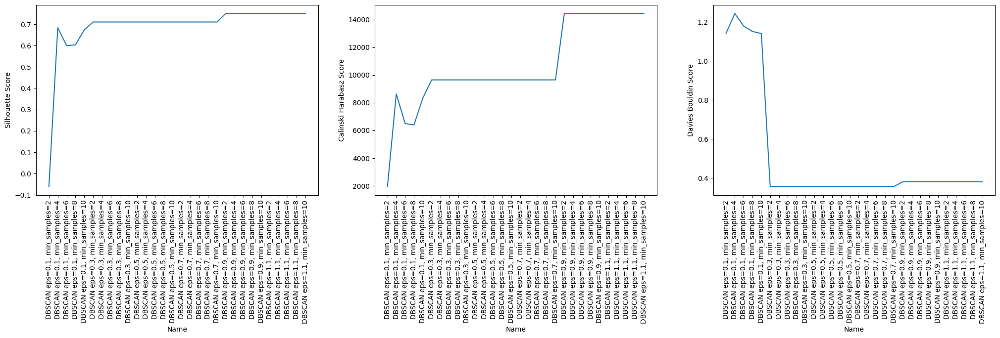

In [40]:
%matplotlib inline

fig, ax = plt.subplots(1, 3, figsize=(25, 5))
sns.lineplot(data=scores, x='Name', y='Silhouette Score', ax=ax[0])
ax[0].xaxis.set_tick_params(rotation=90)

sns.lineplot(data=scores, x='Name', y='Calinski Harabasz Score', ax=ax[1])
ax[1].xaxis.set_tick_params(rotation=90)

sns.lineplot(data=scores, x='Name', y='Davies Bouldin Score', ax=ax[2])
ax[2].xaxis.set_tick_params(rotation=90)